# Hate Speech Detection Twitter 

## *Is possible to indentify and annonated Tweets in a codeswitched language(text)*

![banner](Preprocessing\visualizations\banner.png)


# Overview

This project aims to **automate content moderation** to identify hate speech using **machine learning binary classification algorithms.** Baseline models included Random Forest, Naive Bayes, Logistic Regression and Support Vector Machine (SVM). The final model was a **Logistic Regression** model that used Count Vectorization for feature engineering. It produced an F1 of 0.31053  and Recall (TPR) of 0.624. This performance can be attributed to the massive class imbalance and the model's inability to "understand" the nuances of English  and Swahili slurs[CodeSwitched]. Ultimately, automating hate speech detection is an extremely difficult task. And although this project was able to get that process started, there is more work to be done in order to keep this content off of public-facing forums such as Twitter.

An **interactive version** of the final model is hosted on Heroku. Check it out [here](https://hate-speech-predictor.herokuapp.com/)!

#  Problem

Human content moderation is a very expensive operation,there are many tweets released over a particular period of that will require corpartion,goverment bodies to hundreds of thousands of people to annonate the tweets.To be able to accomplish this,this project build an automated content moderator for Twitter.

There exsist no universal defination of what is hate speech. Different/corpations  bodies around have diferent defination of what hate speech is;

    ***Kenya National Cohesion and Integration Commission*** (NCIC) Act, 2008] :Content that promotes violence against or has the primary purpose of inciting hatred against individuals or groups based on certain attributes, such as race or ethnic origin, religion, disability, gender, age, veteran status, sexual orientation/gender identity.

    Twitter hateful conduct policy; You may not promote violence against or directly attack or threaten other people on the basis of race, ethnicity, national origin, sexual orientation, gender, gender identity, religious affiliation, age, disability, or disease. We also do not allow accounts whose primary purpose is inciting harm towards others on the basis of these categories.


Any company with an online forum where users post content could benefit from automating as much as the moderation process as possible. Ultimately, human content moderation is not only detrimental to workers, but also presents a liability to companies that use them.

**Warning:** This notebook might contains offensive language from the dataset.

# Data & Methods

The corpus used in this project is sourced from kaggle. The corpus contains tweets from twitter 
collected during the 2017 election period and during the election re-run. The dataset can be found [here](https://github.com/t-davidson/hate-speech-and-offensive-language). The dataset is provided as a `.csv` file with 50,184 text posts from Twitter where **6.49% of the tweets were labeled as hate speech**. 

Since content moderation is so subjective, the labels on this dataset were voted on by a team of human beings and determined by majority-rules. The “class” column labels each tweet as 0 for hate speech, 1 for offensive language or 2 for neither. In order to create a different project and adapt the data to my specific business context, I  treated the data as a binary classification problem. 

Therefore, the final model  **predicted whether a tweet is hate speech or not.** To prepare the data for this, I replaced existing 1 and 2 values as 0, and replacing 0 as 1 to indicate hate speech.

### 1. What are the linguistic differences between hate speech and offensive language?

![wordcounty.](Preprocessing\visualizations\wordcounty.png)

The code for this graph can be found in [`eda_notebook.ipynb`]

Linguistically, it's important to note that the difference between hate speech and offensive language often comes down to how it targets marginalized communities, often in threatening ways.

Although these graphs have very similar frequently occurring words, there are a few that stand out. For instance, we can notice from this figure that Hate Speech typically contains the more tribal pointing like "kikuyu" "Luos"
. **The use of this slur could indicate malicious intent, which goes beyond possibly using the word as slang.**

Examples like that one demonstrate the nuances of English/Swahili slang and the fine/thin line between Hate Speech and offensive language. **Because of the similarities of each label’s vocabulary, it could be difficult for machine learning algorithms to differentiate between them and determine what counts as Hate Speech.**

### 2. What are the most popular hashtags of each tweet type?

![wordcountbargraphs](Preprocessing\visualizations\wordcountbargraphs.png)

The code for this graph can be found in [`censored_hashtags.ipynb`]

From these word clouds, we can see some more parallels and differences between what is classified as hate speech or not. For instance, #kot stands for "Kenyans on Twitter” and it appears in both groups. However, #luolivesmatter, which refers to those who identify with the CORD COLIATION, that is primarily (but not exclusively) associated with the Jubilee Coliation, appears in only the “Not Hate Speech” cloud. Both hashtags are used among Alt-Right  sides .

Additionally, the ##githeriman hashtag appears in only the "Not Hate Speech" cloud. This was the man who trended for his githeri stunt. Knowing the context, we know that hashtag could certainly include text that constitutes as non hate speech. With this, and other hashtags that appear in the “Not Hate Speech” cloud, we can clearly see the very slight differences between the two labels.



### 3. What is the overall polarity of the tweets?

![notsatirewordcloud](Preprocessing\visualizations\notsatirewordcloud.png)


The code for this graph can be found in [`VADER_sentiment.ipynb`](https://github.com/sidneykung/twitter_hate_speech_detection/blob/master/preprocessing/VADER_sentiment.ipynb).

The compound polarity score is a metric that calculates the sum of all the [lexicon ratings]which have been normalized between -1 and +1. With -1 being extreme negative and +1 being extreme positive.

 **This score encompasses the overall sentiment of this corpus.**

- Hate Speech tweets on average have a compound score of -0.033625
- Non Hate Speech tweets on average have a compound score of -0.182535

According to this metric, both classes of tweets have pretty negative sentiments because their normalized compound scores are less than the threshold of -0.05. 

Additionally from the graph above, we can see that tweets classified as Hate Speech are especially negative. This further emphasizes how slim the difference between the two labels are. Although both classes contain negative and offensive language, Hate Speech is much more negative on average.


![avgpolaritybytweettype](Preprocessing\visualizations\avgpolaritybytweettype.png)


The code for this graph can be found in [`VADER_sentiment.ipynb`]

To reiterate, this graph shows the average polarity scores for each label. Which are positive, neutral or negative. We can see that a majority were scored as neutral. However, of those that were scored as negative, it seems like "Not Hate Speech" had more on average. This is probably because of the class imbalance.

## Class Imbalance

The main roadblock of this dataset is the extreme class imbalance. We can see that only 6.46% of the data is labeled as hate speech. This could present challenges during the modeling process.

![cleanedclassimbalance](Preprocessing\visualizations\cleanedclassimbalance.png)

The code for this graph can be found in [`data_cleaning.ipynb`]

In [2]:
# importing relevant libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm
import seaborn as sns
%matplotlib inline
plt.style.use('bmh')
import pickle
# custom fuctions
from src import helper_functions as helpers

# NLP libraries
import nltk
from sklearn.feature_extraction import text 
from nltk.stem import WordNetLemmatizer, PorterStemmer
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer, TfidfTransformer
from nltk.probability import FreqDist
from nltk.corpus import stopwords
from gensim.models.doc2vec import Doc2Vec, TaggedDocument

# modeling libraries
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import TomekLinks
from collections import Counter
from sklearn import metrics, utils, model_selection, svm
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix, plot_confusion_matrix, classification_report

# Preprocessing Text Data

The original data from `Codeswitched dataset` was cleaned using RegEx in the `data_cleaning.ipynb` notebook. 

**Cleaning Steps:**

- Reassigning labels
- Lowercasing tweet text
- Removing hashtags, mentions, quotes and punctuation from tweet text
- Checking for missing values

In [3]:
# loading in clean_df
clean_df = pd.read_pickle(r'C:\Users\Ricky\Desktop\4.2 FINAL SEMESTER\PROJECT II  Computer systems Project\rOOT\Preprocessing\clean_df.pkl')

In [4]:
# previewing data
clean_df.head(3)

,total_votes,hate_speech_votes,other_votes,label,tweet,clean_tweets
0,3,1,3,0,kindly say bickering to kikuyus and kalenjins....,kindly say bickering to kikuyus and kalenjins ...
1,3,1,3,0,kindly remind them that we do not have thoroug...,kindly remind them that we do not have thoroug...
2,3,1,3,0,kindly look at moses' statement. where has he ...,kindly look at moses statement where has he sa...


From here, we'll be focusing on the `clean_tweets` column and the target variable, `label`.

## Tokenizing & Removing Stop Words

When working with text data, one of the first steps is to remove stop words from the corpus. Although text would be gramatically incorrect without these stop words, they provide little value to models and typically hinder performace.

We can use NLTK's built-in library of stop words to remove them in a tokenizing function.

In [5]:
# assigning variables to essential columns
data = clean_df['clean_tweets']
target = clean_df['label']

In [6]:
data[:4000].values

array(['kindly say bickering to kikuyus and kalenjins the rest of the country with him',
       'kindly remind them that we do not have thoroughbred kikuyus but rather a mix of',
       'kindly look at moses statement where has he said i will kill u hmmmmguys stop putting words which werent spokensaying nitamzima mimi doesnt mean hr is gona kill him bt deal with him until he silences thru law',
       ..., 'what will happen next ',
       'what will be the measure of free and fair my friend',
       'what were they saying in '], dtype=object)

In [7]:
# setting NLTK stop words as `stop_words`
stop_words = set(stopwords.words('english'))

Next, we can use the `process_tweet` helper function, which tokenizes all the text and removes stop words.

In [8]:
# applying the above function to our `clean_tweets`
processed_data = list(map(helpers.process_tweet, data))

In [9]:
# getting count of all unique words in the corpus
total_vocab = set()
for comment in processed_data:
    total_vocab.update(comment)
len(total_vocab)

51084

In [11]:
data[:4000]

0       kindly say bickering to kikuyus and kalenjins ...
1       kindly remind them that we do not have thoroug...
2       kindly look at moses statement where has he sa...
3       kindly like this pagewtf fun facts maasai are ...
4       kindly kikuyus humble yourselves in and take t...
                              ...                        
3995     what would you have gained supposed they drowned
3996          what will you gain from this we are kikuyus
3997                               what will happen next 
3998    what will be the measure of free and fair my f...
3999                            what were they saying in 
Name: clean_tweets, Length: 4000, dtype: object

In [10]:
helpers.process_tweet

<function src.helper_functions.process_tweet(text)>

In [11]:
processed_data 

[['kindly', 'say', 'bickering', 'kikuyus', 'kalenjins', 'rest', 'country'],
 ['kindly', 'remind', 'thoroughbred', 'kikuyus', 'rather', 'mix'],
 ['kindly',
  'look',
  'moses',
  'statement',
  'said',
  'kill',
  'u',
  'hmmmmguys',
  'stop',
  'putting',
  'words',
  'werent',
  'spokensaying',
  'nitamzima',
  'mimi',
  'doesnt',
  'mean',
  'hr',
  'gona',
  'kill',
  'bt',
  'deal',
  'silences',
  'thru',
  'law'],
 ['kindly',
  'like',
  'pagewtf',
  'fun',
  'facts',
  'maasai',
  'tribe',
  'kenya',
  'mentioned',
  'bible',
  'exclusive'],
 ['kindly', 'kikuyus', 'humble', 'take', 'man', 'back', 'sigoi', 'belongs'],
 ['kill',
  'ignorant',
  'facts',
  'difficult',
  'understand',
  'elder',
  'odinga',
  'always',
  'mocked',
  'majority',
  'kikuyus',
  'yet',
  'hes',
  'always',
  'side'],
 ['kill',
  'business',
  'politicians',
  'kill',
  'people',
  'kill',
  'anything',
  'never',
  'kill',
  'bright',
  'minds',
  'luhya',
  'nation',
  'standing',
  'firm'],
 ['kill'

In [12]:
# getting count of all unique words in the corpus
total_vocab = set()
for comment in processed_data:
    total_vocab.update(comment)
len(total_vocab)

51084

We can see that **the corpus has a vocabulary of 51,084 unique words**. This is useful to know because that will be the amount of columns in the sparse matrix after TF-IDF Vectorization. 

## Top Words in Corpus

In [15]:
processed_data

[['kindly', 'say', 'bickering', 'kikuyus', 'kalenjins', 'rest', 'country'],
 ['kindly', 'remind', 'thoroughbred', 'kikuyus', 'rather', 'mix'],
 ['kindly',
  'look',
  'moses',
  'statement',
  'said',
  'kill',
  'u',
  'hmmmmguys',
  'stop',
  'putting',
  'words',
  'werent',
  'spokensaying',
  'nitamzima',
  'mimi',
  'doesnt',
  'mean',
  'hr',
  'gona',
  'kill',
  'bt',
  'deal',
  'silences',
  'thru',
  'law'],
 ['kindly',
  'like',
  'pagewtf',
  'fun',
  'facts',
  'maasai',
  'tribe',
  'kenya',
  'mentioned',
  'bible',
  'exclusive'],
 ['kindly', 'kikuyus', 'humble', 'take', 'man', 'back', 'sigoi', 'belongs'],
 ['kill',
  'ignorant',
  'facts',
  'difficult',
  'understand',
  'elder',
  'odinga',
  'always',
  'mocked',
  'majority',
  'kikuyus',
  'yet',
  'hes',
  'always',
  'side'],
 ['kill',
  'business',
  'politicians',
  'kill',
  'people',
  'kill',
  'anything',
  'never',
  'kill',
  'bright',
  'minds',
  'luhya',
  'nation',
  'standing',
  'firm'],
 ['kill'

In [13]:
# transforming `processed_data` into a readable list
flat_filtered = [item for sublist in processed_data for item in sublist]
# getting frequency distribution
clean_corpus_freqdist = FreqDist(flat_filtered)
# top 20 words in cleaned corpus
clean_corpus_freqdist.most_common(20)

[('kikuyus', 8045),
 ('luos', 4769),
 ('nyakundi', 2934),
 ('pictwittercom', 2883),
 ('kenya', 2728),
 ('people', 2667),
 ('like', 2400),
 ('na', 2188),
 ('us', 2122),
 ('hate', 2099),
 ('dont', 2054),
 ('uhuru', 1984),
 ('one', 1909),
 ('kalenjins', 1901),
 ('know', 1875),
 ('kenyans', 1859),
 ('u', 1803),
 ('ni', 1761),
 ('luhyas', 1693),
 ('raila', 1576)]

In [ ]:
flat_filtered

['kindly',
 'say',
 'bickering',
 'kikuyus',
 'kalenjins',
 'rest',
 'country',
 'kindly',
 'remind',
 'thoroughbred',
 'kikuyus',
 'rather',
 'mix',
 'kindly',
 'look',
 'moses',
 'statement',
 'said',
 'kill',
 'u',
 'hmmmmguys',
 'stop',
 'putting',
 'words',
 'werent',
 'spokensaying',
 'nitamzima',
 'mimi',
 'doesnt',
 'mean',
 'hr',
 'gona',
 'kill',
 'bt',
 'deal',
 'silences',
 'thru',
 'law',
 'kindly',
 'like',
 'pagewtf',
 'fun',
 'facts',
 'maasai',
 'tribe',
 'kenya',
 'mentioned',
 'bible',
 'exclusive',
 'kindly',
 'kikuyus',
 'humble',
 'take',
 'man',
 'back',
 'sigoi',
 'belongs',
 'kill',
 'ignorant',
 'facts',
 'difficult',
 'understand',
 'elder',
 'odinga',
 'always',
 'mocked',
 'majority',
 'kikuyus',
 'yet',
 'hes',
 'always',
 'side',
 'kill',
 'business',
 'politicians',
 'kill',
 'people',
 'kill',
 'anything',
 'never',
 'kill',
 'bright',
 'minds',
 'luhya',
 'nation',
 'standing',
 'firm',
 'kill',
 'elephants',
 'uneasy',
 'truce',
 'maasai',
 'nature',


In [14]:
clean_corpus_freqdist.most_common(20)

[('kikuyus', 8045),
 ('luos', 4769),
 ('nyakundi', 2934),
 ('pictwittercom', 2883),
 ('kenya', 2728),
 ('people', 2667),
 ('like', 2400),
 ('na', 2188),
 ('us', 2122),
 ('hate', 2099),
 ('dont', 2054),
 ('uhuru', 1984),
 ('one', 1909),
 ('kalenjins', 1901),
 ('know', 1875),
 ('kenyans', 1859),
 ('u', 1803),
 ('ni', 1761),
 ('luhyas', 1693),
 ('raila', 1576)]

These top words are mostly offensive terms, and some other slang words that the NLTK stop words removal function didn't pick up.

For a breakdown of the top words in each label, refer to ['eda_notebook.ipynb']

## Lemmatization

This last method reduces each word into a linguistically valid **lemma**, or **root word**. It does this through linguistic mappings, using the WordNet lexical database.


In [15]:
# creating a list with all lemmatized outputs
lemmatizer = WordNetLemmatizer() 
lemmatized_output = []

for listy in processed_data:
    lemmed = ' '.join([lemmatizer.lemmatize(w) for w in listy])
    lemmatized_output.append(lemmed)

In [ ]:
lemmatized_output 

['kindly say bickering kikuyus kalenjins rest country',
 'kindly remind thoroughbred kikuyus rather mix',
 'kindly look moses statement said kill u hmmmmguys stop putting word werent spokensaying nitamzima mimi doesnt mean hr gona kill bt deal silence thru law',
 'kindly like pagewtf fun fact maasai tribe kenya mentioned bible exclusive',
 'kindly kikuyus humble take man back sigoi belongs',
 'kill ignorant fact difficult understand elder odinga always mocked majority kikuyus yet he always side',
 'kill business politician kill people kill anything never kill bright mind luhya nation standing firm',
 'kill elephant uneasy truce maasai nature cnncom',
 'kilifi lamu kwale mombasa â\x80\x9ccoastâ\x80\x9c term used kikuyus hater creat fear economic isolation kikuyu people',
 'kikuyus peaceful people agree costed u alot kibaki thing uhuru u know landed u',
 'kikuyus wont lecture u know aug election there neg preacher doom',
 'kikuyus average mind take literally uhuru call mganga uhuru know 

In [16]:
X_lem = lemmatized_output
y_lem = target

In [12]:
y_lem.size

50175

Now `X_lem` and `y_lem` are contain cleaned text and the original labels, ready to be used for modeling.

# Feature Engineering

With Natural Language Processing, the purpose of feature engineering is to transform the tokenized text data into numerical vectors that the machine learning algorithm can "understand."

In this notebook, we'll be iterating through three different feature engineering techniques: **Count Vectorization, TF-IDF Vectorization and Doc2Vec**. Trying out these techniques could yield vastly different metrics on the same four baseline models.

## Train-Test Split
First, let's perform a train-test split of the dataset, where 20% is reserved as unseen testing data.

In [17]:
from sklearn.model_selection import train_test_split

In [18]:
# initial TTS
X_train, X_test, y_train, y_test = train_test_split(X_lem, y_lem, test_size=0.20, random_state=15)

In [23]:
X_lem

['kindly say bickering kikuyus kalenjins rest country',
 'kindly remind thoroughbred kikuyus rather mix',
 'kindly look moses statement said kill u hmmmmguys stop putting word werent spokensaying nitamzima mimi doesnt mean hr gona kill bt deal silence thru law',
 'kindly like pagewtf fun fact maasai tribe kenya mentioned bible exclusive',
 'kindly kikuyus humble take man back sigoi belongs',
 'kill ignorant fact difficult understand elder odinga always mocked majority kikuyus yet he always side',
 'kill business politician kill people kill anything never kill bright mind luhya nation standing firm',
 'kill elephant uneasy truce maasai nature cnncom',
 'kilifi lamu kwale mombasa â\x80\x9ccoastâ\x80\x9c term used kikuyus hater creat fear economic isolation kikuyu people',
 'kikuyus peaceful people agree costed u alot kibaki thing uhuru u know landed u',
 'kikuyus wont lecture u know aug election there neg preacher doom',
 'kikuyus average mind take literally uhuru call mganga uhuru know 

In [24]:
X_train

['lying dont worship bab people worship people like raila uhuru known nyakundi list',
 'shldnt even bow people r dying kisumu even luo still kenyan kill option',
 'kikuyus afraid monicah juma qualified woman kenya',
 'silly kikuyus insist insulting luo calling kihiis expect u live peace nkt',
 'phone keep thinking wan na update still chase hoe thatâ\x80\x99s enough proof',
 'last time kikuyu politician questioned kenyattas land grabbing affected many kikuyus',
 'shall sensitise people reform must take place called another election',
 'service delivery meter counting there power black happening monopoly misusing customer',
 'kikuyus greedy n selfish thats even kill parent order inherit wealth didnt sweat useless people eva',
 'whi moses kuria arrested perishing nstion two thief',
 'beautiful memory jubilee let story old labrador move tear',
 'winner france actually scottish auld alliance applies uk claiming belgian kenyan welsh men british',
 'trade carefully meru dont criticise meru pe

In [25]:
y_train

21526    0
19889    0
49198    1
48769    1
24679    0
        ..
39296    0
49015    1
2693     0
8076     0
7624     0
Name: label, Length: 40140, dtype: int64

## TF-IDF Vectorization

First, we’ll be trying one of the most popular methods, TF-IDF Vectorization.

This is an acronym that stands for “Term Frequency — Inverse Document” Frequency which are the components of the resulting scores assigned to each word.
- Term Frequency: This summarizes how often a given word appears within a document.
- Inverse Document Frequency: This down scales words that appear a lot across documents.

Without going into the math, TF-IDF are word frequency scores that try to highlight words that are more interesting, e.g. frequent in a document but not across other documents.

In [19]:
# instantiating tf_idf vectorizer
tfidf = TfidfVectorizer(stop_words= stop_words, ngram_range=(1,2))

In [20]:
# transforming tokenized data into sparse matrix format with 50k stored elements
X_train_tfidf = tfidf.fit_transform(X_train)
X_test_tfidf = tfidf.transform(X_test)

In [21]:
# taking a quick look at the non zero elements
non_zero_cols = X_train_tfidf.nnz / float(X_train_tfidf.shape[0])
print("Average Number of Non-Zero Elements in Vectorized Articles: {}".format(non_zero_cols))
percent_sparse = 1 - (non_zero_cols / float(X_train_tfidf.shape[1]))
print('Percentage of columns containing ZERO: {}'.format(percent_sparse))

Average Number of Non-Zero Elements in Vectorized Articles: 17.34142999501744
Percentage of columns containing ZERO: 0.9999414073576187


Here, we can see that 99.9% of the columns contain a zero, meaning that's a very **sparse matrix** with 50k columns. We know the amount of columns because it's the size of the total corpus vocabulary. Additionally, it seems that the average length of the individual tweets is 17 words.

# Modeling Process

## Evaluation Metrics

For this  problem, **we will use F1 score as the main metric**, while also looking at Precision and Recall. The F1 score finds the harmonic mean between Precision and Recall, and it's useful for data with high class imbalance.

**Overall, we want as much hate speech to flagged as possible** and so that it can be efficiently removed. This means also **optomizing the True Positive Rate**, a.k.a Recall.

### Weighted F1 Score

We will also be looking at the weighted F1 score, as it **can account for the class imbalance in labels by calculating metrics for each label**. It finds their average weighted by support (the number of true instances for each label). This results in a F1 score that is not between precision and recall.

### Cross Validation

Additionally, in order to see **whether a model is overfit or underfit**, we can use K-Fold Cross Validation to generate a F1 score for the training set. 

This method uses a limited sample in order to estimate how the model is expected to perform when making predictions on unseen data. For each model, 'K" aka the number of folds will be 5. This means that the data sample will be split into 5 groups and each used as the test set.

# Baseline Modeling

In this section we'll be running baseline Randon Forest, Logistic Regression, Naive Bayes and Support Vector Machine (SVM) models. Out of those 4 models, the best performing one will be selected to iterate through to achieve an MVP.

## Baseline Random Forest

***A random forest model*** is an ensamble method that uses multiple Decision Trees to try to predict the output variable. Typically, it's one of the best performing models for classification problems.

In [22]:
rf_baseline = RandomForestClassifier(n_estimators=100, class_weight='balanced', random_state=0)

Note that adding `class_weight='balanced'` actually increaased precision, but decreased F1.That hyperparameter We'll kept in there, because it would need to be added eventually anyway, to deal with the huge class imbalance in this dataset.

⏳ the cell below takes about 25min 24s to run

In [23]:
%%time
rf_baseline.fit(X_train_tfidf, y_train)
rf_test_preds = rf_baseline.predict(X_test_tfidf)

#Wall time: 25min 24s

Wall time: 6min 9s


In [24]:
pickle.dump(rf_baseline,open(r'C:\Users\Ricky\Desktop\4.2 FINAL SEMESTER\PROJECT II  Computer systems Project\rOOT\Preprocessing\pickle\rf_baseline.pkl','wb'))

In [25]:
pickle.dump(rf_baseline,open(r'C:\Users\Ricky\Desktop\4.2 FINAL SEMESTER\PROJECT II  Computer systems Project\rOOT\Preprocessing\pickle\rf_test_preds .pkl','wb'))

In [26]:
with open(r'C:\Users\Ricky\Desktop\4.2 FINAL SEMESTER\PROJECT II  Computer systems Project\rOOT\Preprocessing\pickle\rf_baseline.pkl','rb') as f:
    rf_baseline=pickle.load(f)

In [27]:
rf_baseline

RandomForestClassifier(class_weight='balanced', random_state=0)

In [28]:
rf_precision = precision_score(y_test, rf_test_preds)
rf_recall = recall_score(y_test, rf_test_preds)
rf_f1_score = f1_score(y_test, rf_test_preds)
rf_f1_weighted = f1_score(y_test, rf_test_preds, average='weighted')

# printing scores
helpers.evaluation(rf_precision, rf_recall, rf_f1_score, rf_f1_weighted)

Testing Set Evaluation Metrics:
Precision: 0.4706
Recall: 0.0354
F1 Score: 0.06584
Weighted F1 Score: 0.9041


These scores are not ideal becuase the F1 is being brought down on how the model predicts the "Hate Speech" label. The weighted F1 score mostly shows how the model is predicting the majority class, "Not Hate Speech". From here, we should try other baseline models to see if the uniform F1 can improve.

Additionally, as mentioned, we can take the cross validated F1 for the training set to determine whether each model is overfit or underfit.

⏳ the cell below takes about  5h 55min 58s  minutes to run

In [29]:
%%time
# training f1
rf_f1_cv = cross_val_score(rf_baseline, X_train_tfidf, y_train, scoring='f1', cv=5)
rf_mean_cv = round(rf_f1_cv.mean(), 6)
#Wall time: 5h 55min 58s

Wall time: 1h 19min 6s


In [30]:
pickle.dump(cross_val_score,open(r'C:\Users\Ricky\Desktop\4.2 FINAL SEMESTER\PROJECT II  Computer systems Project\rOOT\Preprocessing\pickle\rf_f1_cv.pkl','wb'))

In [31]:
# is this model overfit or underfit?
rf_fit = helpers.model_fit(rf_mean_cv, rf_f1_score)
rf_fit

'underfit'

### Overfit vs. Underfit

Above, I used a custom function to streamline the categorization process. For instance, when a model's training metrics are higher than its testing metrics, then it is **overfit**.

Generally, a slightly underfit model is preferred. This means that the model is not too specific to the training data, and it should be able to generalize well on unseen data.

We can continue to run this custom fuction on future iterations to determine each model's fit. We can also store all the testing set evaluation metrics for each model into a dictionary, and display them in a dataframe later for comparison.

In [32]:
# creating dictionary to store all metrics
metric_dict = {}
# adding scores to metric_dict
metric_dict['Baseline Random Forest - TFIDF'] = {'precision': rf_precision, 'recall': rf_recall, 'f1_score': rf_f1_score, 'weighted_f1': rf_f1_weighted, 'fit': rf_fit}

## Baseline Logistic Regression

Logistic Regression is another common model used for classification tasks. Additionally, this model tends to work better with larger datasets.

In [33]:
log_reg_baseline = LogisticRegression(penalty='l2', class_weight='balanced', random_state=20)
# class_weight='balanced' actually didn't impact the score

Here I added `class_weight='balanced'` again, but this actually didn't impact the score. So we'll keep that hyperparamter. Also note that the penality is set to `L2`, but that's already the default.

⏳ the cell below takes about 3 seconds to run

In [34]:
%%time
log_reg_baseline.fit(X_train_tfidf, y_train)
log_reg_test_preds = log_reg_baseline.predict(X_test_tfidf)

Wall time: 9.89 s


In [35]:
log_reg_precision = precision_score(y_test, log_reg_test_preds)
log_reg_recall = recall_score(y_test, log_reg_test_preds)
log_reg_f1_score = f1_score(y_test, log_reg_test_preds)
log_reg_f1_weighted = f1_score(y_test, log_reg_test_preds, average='weighted')

# printing scores
helpers.evaluation(log_reg_precision, log_reg_recall, log_reg_f1_score, log_reg_f1_weighted)

Testing Set Evaluation Metrics:
Precision: 0.2199
Recall: 0.6799
F1 Score: 0.3324
Weighted F1 Score: 0.8551


Compared the the first **Random Forest baseline, the Logistic Regression baseline** performed much better. The F1 score increased from  0.06584 to  0.3324.

Although, this F1 score could still be increased. Before deciding on the model to iterate on, let's try Naive Bayes and SVM baselines first.

⏳ the cell below takes about 13 seconds to run

In [36]:
%%time
# training f1
log_reg_f1_cv = cross_val_score(log_reg_baseline, X_train_tfidf, y_train, scoring='f1', cv=5)
log_reg_mean_cv = round(log_reg_f1_cv.mean(), 6)


Wall time: 26.3 s


In [37]:
# is this model overfit or underfit?
log_reg_fit = helpers.model_fit(log_reg_mean_cv, log_reg_f1_score)
log_reg_fit

'underfit'

In [38]:
# creating dictionary to store all metrics
metric_dict = {}
# adding scores to metric_dict
metric_dict['Baseline Random Forest - TFIDF'] = {'precision': rf_precision, 'recall': rf_recall, 'f1_score': rf_f1_score, 'weighted_f1': rf_f1_weighted, 'fit': rf_fit}

## Baseline Naive Bayes

This model is another common baseline classification algorithm that uses Bayes Theorem with an assumption of independence between predictors. However, this assumption of independence is usually violated because the predictors are typically correlated to each other. That's where the "Naive" comes from.

Naive Bayes is a popular choice for text classification because it classifies based on the probabilities of events. Another pro is that this model takes less time to train.

In [39]:
baseline_bayes = MultinomialNB(alpha = .01)

⏳ the cell below takes about  54 ms to run

In [40]:
%%time
baseline_bayes.fit(X_train_tfidf, y_train)
bayes_test_preds = baseline_bayes.predict(X_test_tfidf)

Wall time: 54 ms


In [41]:
bayes_precision = precision_score(y_test, bayes_test_preds)
bayes_recall = recall_score(y_test, bayes_test_preds)
bayes_f1_score = f1_score(y_test, bayes_test_preds)
bayes_f1_weighted = f1_score(y_test, bayes_test_preds, average='weighted')

# printing scores
helpers.evaluation(bayes_precision, bayes_recall, bayes_f1_score, bayes_f1_weighted)

Testing Set Evaluation Metrics:
Precision: 0.3834
Recall: 0.1091
F1 Score: 0.1699
Weighted F1 Score: 0.9088


The F1 score dropped down to  0.1699. So, this model performed worse than both the Random Forest and Logistic Regression models. This is surprising because Naive Bayes typically performs pretty well with text data. This could indicate that preprocessing steps could be improved.

I tried the last baseline to decide which model to iterate on.

⏳ the cell below takes about  to run

In [42]:
%%time
# training f1
bayes_f1_cv = cross_val_score(baseline_bayes, X_train_tfidf, y_train, scoring='f1', cv=5)
bayes_mean_cv = round(bayes_f1_cv.mean(), 6)

Wall time: 280 ms


In [43]:
bayes_fit = helpers.model_fit(bayes_mean_cv, bayes_f1_score)
bayes_fit

'underfit'

In [44]:
# adding scores to metric_dict
metric_dict['Baseline Naive Bayes - TFIDF'] = {'precision': bayes_precision, 'recall': bayes_recall, 'f1_score': bayes_f1_score, 'weighted_f1': bayes_f1_weighted, 'fit': bayes_fit}

## Baseline Support Vector Machine (SVM)

An SVM is a type of classifier that modifies the loss function for optimization to not only take into account overall accuracy metrics of the resulting predictions, but also to maximize the decision boundary between the data points. Essentially, this further helps tune the classifier as a good balance between underfitting and overfitting.

A notable hyperparameter is the Kernel, which reprojects data onto a new parameter space using combinations of existing features. From there, the same process of applying SVMs to this transformed space can then be employed. This could provide more complex boundaries than just Linear.

For now, let's try an SVM with a Linear kernel as a baseline.

In [45]:
SVM_baseline = svm.SVC(C=1.0, kernel='linear', degree=3, gamma='auto', class_weight='balanced')

Notice that you can also add `class_weight='balanced'` to SVM models. This can help preemptively deal with the huge class imbalance in this dataset.

⏳ the cell below takes about 1 minute to run

In [46]:
%%time 
# fit the training dataset on the classifier
SVM_baseline.fit(X_train_tfidf, y_train)
# predict the labels on validation dataset
SVM_test_preds = SVM_baseline.predict(X_test_tfidf)
#Wall time: 30min 38s

Wall time: 9min 17s


In [47]:
pickle.dump(cross_val_score,open(r'C:\Users\Ricky\Desktop\4.2 FINAL SEMESTER\PROJECT II  Computer systems Project\rOOT\Preprocessing\pickle\SVM_baseline.fit.pkl','wb'))

In [ ]:
pickle.dump(cross_val_score,open(r'C:\Users\Ricky\Desktop\4.2 FINAL SEMESTER\PROJECT II  Computer systems Project\rOOT\Preprocessing\pickle\SVM_baseline.predict.pkl:','wb'))

In [49]:
SVM_precision = precision_score(y_test, SVM_test_preds)
SVM_recall = recall_score(y_test, SVM_test_preds)
SVM_f1_score = f1_score(y_test, SVM_test_preds)
SVM_f1_weighted = f1_score(y_test, SVM_test_preds, average='weighted')

# printing scores
helpers.evaluation(SVM_precision, SVM_recall, SVM_f1_score, SVM_f1_weighted)

Testing Set Evaluation Metrics:
Precision: 0.3176
Recall: 0.3378
F1 Score: 0.3274
Weighted F1 Score: 0.9076


This model produced the second highest F1 so far, with a score of .0.3274. Next, let's look at the performance of all baselines all together, and move forward with a single model to iterate on. 

⏳ the cell below takes about 3 minutes to run

In [51]:
%%time
# training f1
base_SVM_f1_cv = cross_val_score(SVM_baseline, X_train_tfidf, y_train,scoring='f1', cv=5)
base_SVM_mean_cv = round(base_SVM_f1_cv.mean(), 6)

Wall time: 29min 54s


In [52]:
# is this model overfit or underfit?
base_SVM_fit = helpers.model_fit(base_SVM_mean_cv, SVM_f1_score)
base_SVM_fit

'underfit'

In [53]:
# adding scores to metric_dict
metric_dict['Baseline SVM - TFIDF'] = {'precision': SVM_precision, 'recall': SVM_recall, 'f1_score': SVM_f1_score, 'weighted_f1': SVM_f1_weighted, 'fit': base_SVM_fit}

## Evaluation Metrics for All Baseline Models

In [54]:
# printing dict for testing set metrics
pd.DataFrame.from_dict(metric_dict, orient='index')

,precision,recall,f1_score,weighted_f1,fit
Baseline Random Forest - TFIDF,0.470588,0.035398,0.065844,0.904054,underfit
Baseline Naive Bayes - TFIDF,0.383420,0.109145,0.169920,0.908803,underfit
Baseline SVM - TFIDF,0.317614,0.337758,0.327377,0.907561,underfit


It's a pretty close call between the Logistic Regression and SVM baselines. But overall, the **Linear SVM model** performed the best across both uniform and weighted F1. However, there is still work to be done to bring that score up higher. 

Next, we'll try improving that model with other feature engineering techniques, class imbalance remedy methods and tuning hyperparameters with grid search.

***

## Alternative Feature Engineering Methods

In this section, we can experiment with ****Count Vectorization**** and ****Doc2Vec**** as they are different ways to represent the data in a format that the machine learning models can "understand."

## Doc2Vec

One disadvantage to using Count Vectorization or TF-DF Vectorization is that we can run into the Curse of Dimensionality, which occurs when the number of features explodes. This problem happens because these methods create Sparse Vectors, that are the length of the total vocabulary of the text corpus. 

This corpus has a vocabulary of 50184 Therefore, that's the number of columns in the Sparse Matrix, creating a ton of extra space of 99% 0s could possibly hurt the model. 

We can try Doc2Vec feature engineering, which is an extension of Word2Vec. It aims to learn how to project a document into a latent d-dimensional space. Specifically, the Distributed Bag of Words (DBOW) model ignores the context words in the input, but instead forces the model to predict words randomly sampled from the paragraph in the output.

In [55]:
# fresh TTS for doc2vec data
doc_train, doc_test = train_test_split(clean_df, test_size=0.3, random_state=42)

### Data Preparation

After performing a fresh train test split of the original dataframe, the next step is tokenizing the text as usual. Again, we can do this with NLTK.

The lambda functions below will tokenize both the training and test set and tag each tweet with its label, "Hate Speech" or "Not Hate Speech."

In [56]:
# tagging training set
tagged_train = doc_train.apply(
    lambda r: TaggedDocument(words=helpers.tokenize_text(r['clean_tweets']), tags=[r.label]), axis=1)
# tagging testing set
tagged_test = doc_test.apply(
    lambda r: TaggedDocument(words=helpers.tokenize_text(r['clean_tweets']), tags=[r.label]), axis=1)

Let's take a look an example of a tagged tweet.

In [57]:
tagged_train.values[30]

TaggedDocument(words=['we', 'need', 'more', 'from', 'the', 'unfruitful', 'tree', 'to', 'the', 'fruitful', 'winning', 'team', 'jubilee', 'the', 'current', 'slogan', 'to', 'shave'], tags=[0])

Here, you can see that this "Not Hate Speech" tweet has been tokenized and tagged with a `0` label.

### Training DBOW Model

As mentioned before, the Distributed Bag of Words (DBOW) model **ignores the context words** in the input, but instead forces the model to predict words randomly sampled from the paragraph in the output. It's similar to the Skip-gram model in Word2Vec. You can read more about the model in its documentation [here](https://radimrehurek.com/gensim/models/doc2vec.html).

The hyperparameters we'll use are as follows:
- `vector_size`: dimensionality of the feature vectors
- `alpha`: initial learning rate
- `min_count`: ignores all words with total frequency lower than this
- `dm`: defines the training algorithm; when dm=1, 'distributed memeory' (PV-DVM) is used
- `epochs`: number of iterations (epochs) over the corpus, defaults to 10 for Doc2Vec

In [58]:
# instantiating a doc2vec DBOW model
dbow_model = Doc2Vec(vector_size=1000, 
                alpha=0.025, 
                min_count=5,
                dm=1, epochs=1000)

In [71]:
Doc2Vec

gensim.models.doc2vec.Doc2Vec

In [59]:
from tqdm import tqdm
tqdm.pandas(desc="progress-bar")

# building vocabulary 
dbow_model.build_vocab([x for x in tqdm(tagged_train.values)])

100%|██████████| 35122/35122 [00:00<00:00, 2511291.26it/s]


Now that we have built a vocabulary based on the training set, we can initialize the model and train it for 30 epochs.

⏳ the cell below takes about 5min 26 seconds to run

In [60]:
%%time
for epoch in range(30):
    dbow_model.train(utils.shuffle([x for x in tqdm(tagged_train.values)]), total_examples=len(tagged_train.values), epochs=1)
    dbow_model.alpha -= 0.002
    dbow_model.min_alpha = dbow_model.alpha

    #Wall time: 5min 26s

100%|██████████| 35122/35122 [00:00<00:00, 2185027.14it/s]


Wall time: 1min 45s


****deleteeeeeeeee ******

## Applying Doc2Vec Data to Train Baseline Linear SVM

The custom function `vec_for_learning` simply transforms the tagged tweets into vectors that are suitable for classification model use.

In [61]:
train_data, test_data = train_test_split(data)

In [62]:
# train-test split
doc_y_train, doc_X_train = helpers.vec_for_learning(dbow_model, tagged_train)
doc_y_test, doc_X_test = helpers.vec_for_learning(dbow_model, tagged_test)

In [63]:
pickle.dump(rf_baseline,open(r'C:\Users\Ricky\Desktop\4.2 FINAL SEMESTER\PROJECT II  Computer systems Project\rOOT\Preprocessing\pickle\helpers.vec_for_learning.pkl','wb'))

In [77]:
doc_X_test

(array([ 1.75425977e-01,  4.45184521e-02,  1.15376199e-02,  1.22414276e-01,
         2.04143673e-02,  2.30393317e-02,  9.41632017e-02,  1.17111564e-01,
         2.20908727e-02, -1.72368865e-02, -2.56520007e-02, -2.10102461e-02,
        -7.87597299e-02,  2.31701389e-01, -3.99501845e-02,  9.71196592e-02,
         1.09388866e-01,  6.79698912e-03, -1.46319076e-01,  8.86290371e-02,
        -8.35358165e-03,  8.32087472e-02, -4.75997813e-02, -3.75171788e-02,
         1.48369893e-01, -3.47389020e-02,  8.13820362e-02,  4.83879894e-02,
         6.00493588e-02, -6.26004636e-02,  1.44197629e-03, -1.59256533e-01,
         1.78729460e-01,  4.74558249e-02, -1.32208830e-03,  3.33606116e-02,
         8.38988349e-02,  3.50832939e-02, -1.78349968e-02, -7.97733217e-02,
         2.29983628e-02, -1.50697932e-01, -3.86065245e-02,  2.74569485e-02,
         3.92948538e-02, -4.77481559e-02,  9.46154147e-02,  1.21269584e-01,
         1.28625035e-01,  6.88120052e-02, -8.27487465e-03,  8.79728422e-02,
        -5.2

In [64]:
train_tagged =(train_data, 'clean_tweets')
test_tagged =(test_data, 'clean_tweets')

In [65]:
y_train, X_train = (dbow_model, tagged_train)
y_test, X_test = (dbow_model, tagged_test)

In [66]:
# train-test split
doc_y_train, doc_X_train = (dbow_model, tagged_train)
doc_y_test, doc_X_test = (dbow_model, tagged_test)

Next, we feed the Doc2Vec data into the previous Linear SVM model to see how this method compares to TF-IDF Vectorization.

In [67]:
# instantiating new SVM model
Doc2Vec_SVM = svm.SVC(C=1.0, kernel='linear', degree=3, gamma='auto', class_weight='balanced')

In [68]:
doc_y_train

In [69]:
doc_X_test

22506    ([years, on, last, nights, scorecard, will, sh...
14159    ([kikuyus, not, see, transpoed, boat, understa...
44356    ([you, guys, why, is, tribal, when, kikuyus, a...
19219    ([your, stereotyping, is, unfounate, majority,...
4524        ([we, both, know, that, aint, true, man], [0])
                               ...                        
39411    ([hate, luos, but, moses, kurias, comment, was...
19258    ([your, past, is, conquered, when, you, can, u...
26034    ([whos, money, did, msando, decline, governmen...
43337    ([kalonzo, had, to, interrupt, religious, when...
15632    ([kama, hawa, wazungu, wataingia, mbinguni, in...
Length: 15053, dtype: object

In [70]:
from gensim import models

In [71]:
Doc2Vec_SVM 

SVC(class_weight='balanced', gamma='auto', kernel='linear')

In [72]:
svm.SVC()

SVC()

⏳ the cell below takes about 28 seconds to run

In [76]:
import gensim

In [74]:
from gensim.models import KeyedVectors

In [77]:
gensim.models.keyedvectors.KeyedVectors.get_vecattr

<function gensim.models.keyedvectors.KeyedVectors.get_vecattr(self, key, attr)>

In [78]:
doc_y_train, doc_X_train = helpers.vec_for_learning(dbow_model, tagged_train)

In [79]:
doc_y_test, doc_X_test = (dbow_model, tagged_test)

In [81]:
import numpy

In [ ]:
numpy.array([doc_X_train, "doc_y_train"], dtype=object)
57

In [84]:
numpy.mean([doc_y_train,tuple(range(4))]) 

c:\Users\Ricky\anaconda3\lib\site-packages\numpy\core\_asarray.py:171: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return array(a, dtype, copy=False, order=order, subok=True)


array([0. , 0. , 0. , ..., 0.5, 1. , 1.5])

In [85]:
numpy.mean([doc_X_train,tuple(range(4))]) 

c:\Users\Ricky\anaconda3\lib\site-packages\numpy\core\_methods.py:190: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  ret = ret / rcount


array([array([ 4.03054350e-04,  1.20963494e-03,  4.20470210e-03, -1.42074306e-03,
              -9.15100332e-04, -2.57635000e-03, -6.91834139e-05, -4.28104773e-03,
              -5.58615196e-04, -2.44480208e-04, -1.88754464e-03,  3.50359827e-03,
               3.59984767e-03, -6.48579793e-04,  1.52384548e-03, -4.21761815e-03,
               3.22521897e-03,  4.07226849e-03,  3.64543335e-03, -3.67726339e-03,
               1.12990674e-03,  4.87930328e-03, -6.10976387e-03,  3.55005008e-03,
              -2.02646456e-03, -8.34378996e-04, -8.78673792e-03, -3.25342454e-03,
              -2.09868304e-03, -4.49123047e-03,  2.13352521e-03, -3.41285765e-03,
               1.41143403e-03, -4.58947197e-03, -7.01314304e-03,  3.51237785e-03,
              -2.10955157e-03, -5.87897236e-03, -3.63679766e-03, -6.88462867e-04,
              -3.52995144e-03, -5.03612962e-03, -1.82686443e-03, -2.67887139e-03,
               1.54532504e-03, -4.25607432e-03, -1.69304851e-03, -1.37056934e-03,
               9

In [ ]:
doc_y_train

In [86]:
%%time
# fit the training dataset on the classifier
Doc2Vec_SVM.fit(doc_X_train,doc_y_train)

Wall time: 13min 41s


SVC(class_weight='balanced', gamma='auto', kernel='linear')

In [ ]:
doc_X_train

In [ ]:
doc_y_train

In [ ]:
doc_X_test

In [ ]:
doc_X_test.shape

(15053,)

In [ ]:
numpy.array([doc_X_train, "doc_y_train"], dtype=object)

In [ ]:
# predict the labels on testing dataset
doc_SVM_y_preds = Doc2Vec_SVM.predict(doc_X_test)

In [ ]:
numpy.array([doc_y_train, "doc_X_train"], dtype=object)

In [ ]:
numpy.mean([doc_X_test,tuple(range(15053))]) 


In [ ]:
# predict the labels on testing dataset
doc_SVM_y_preds = Doc2Vec_SVM.predict(doc_X_test)

In [ ]:
doc_SVM_precision = precision_score(doc_y_test, doc_SVM_y_preds)
doc_SVM_recall = recall_score(doc_y_test, doc_SVM_y_preds)
doc_SVM_f1_score = f1_score(doc_y_test, doc_SVM_y_preds)
doc_SVM_f1_weighted = f1_score(doc_y_test, doc_SVM_y_preds, average='weighted')

# printing scores
helpers.evaluation(doc_SVM_precision, doc_SVM_recall, doc_SVM_f1_score, doc_SVM_f1_weighted)

Unfortunately, using this method did not produce a great F1 score. It seems that it wasn't even able to predict the "Not Hate Speech" label as well as the other top-performing baselines. Let's compare it with other baselines next.

⏳ the cell below takes about 2 minutes to run

In [89]:
%%time
# training f1
doc_SVM_f1_cv = cross_val_score(Doc2Vec_SVM, doc_X_train, doc_y_train, scoring='f1', cv=5)
doc_SVM_mean_cv = round(doc_SVM_f1_cv.mean(), 6)

Wall time: 52min 38s


In [ ]:
# is this model overfit or underfit?
doc_SVM_fit = helpers.model_fit(doc_SVM_mean_cv, doc_SVM_f1_score)
doc_SVM_fit

Additionally, the Doc2Vec method produced an overfit model. Whereas the TF-IDF vectorization method on the same exact Linear SVM model produced an underfit model.

In [ ]:
metric_dict['Baseline SVM - Doc2Vec'] = {'precision': doc_SVM_precision, 'recall': doc_SVM_recall, 'f1_score': doc_SVM_f1_score, 'weighted_f1': doc_SVM_f1_weighted, 'fit': doc_SVM_fit}

****** deleeetr****

### Comparing with Other Models

In [94]:
# printing dict for testing set metrics
pd.DataFrame.from_dict(metric_dict, orient='index')

,precision,recall,f1_score,weighted_f1,fit
Baseline Random Forest - TFIDF,0.470588,0.035398,0.065844,0.904054,underfit
Baseline Naive Bayes - TFIDF,0.383420,0.109145,0.169920,0.908803,underfit
Baseline SVM - TFIDF,0.317614,0.337758,0.327377,0.907561,underfit


 Baseline Logisitc Regression model didn't perform as well  Linear SVM with TF-IDF Vectorization. 

It's worth noting that **it was able to predict the positive label, "Hate Speech", the best out of all the other baseline models**. However, we are looking for a balance of a high recall and F1 scores. Therefore, the F1 score could still be improved.

Let's look at this closer with a classification report, to see how both SVM models predicted each label using the different vectorization methods.

////
Random Forest
Testing Set Evaluation Metrics:
Precision: 0.4706
Recall: 0.0354
F1 Score: 0.06584
Weighted F1 Score: 0.9041


Baseline Logic Regression
Testing Set Evaluation Metrics:
Precision: 0.2199
Recall: 0.6799
F1 Score: 0.3324
Weighted F1 Score: 0.8551


Naive Bayes
Testing Set Evaluation Metrics:
Precision: 0.3834
Recall: 0.1091
F1 Score: 0.1699
Weighted F1 Score: 0.9088



SVM 
Testing Set Evaluation Metrics:
Precision: 0.3176
Recall: 0.3378
F1 Score: 0.3274
Weighted F1 Score: 0.9076



### SVM Baselines: TF-IDF vs. Doc2Vec

In [ ]:
target_names = ['class 0', 'class 1']
# Tf-IDF baseline
print('-'*14 + ' SVM Baseline with TF-IDF ' + '-'*13)
print(classification_report(y_test, SVM_test_preds, target_names=target_names))
# Doc2Vec baseline
print('-'*13 + ' SVM Baseline with Doc2Vec ' + '-'*13)
print(classification_report(doc_y_test, doc_SVM_y_preds, target_names=target_names))

As mentioned, the Doc2Vec was able to predict more of the positive class "Hate Speech" when it comes to Recall, but the F1 scores for each label are much lower than the TF-IDF vectorization method. Therefore, we won't proceed with this method. Instead, let's try the last feature engineering method, Count Vectorization.

***

## Count Vectorization

*Count Vectorization* is (similar to TF-IDF Vectorization), but it **simply counts the number of times each word appears in a document**. Therefore, each individual tweet becomes a single vector where each element in the vector corresponds to the count of a unique word.

It's worth noting that when we vectorize text in this way, we lose the order that the sentences were in. This is known as the **Bag of Words** appraoch, because all of the tokenized words in the corpus are thrown into a "bag" of vectors for the model to "understand."

In [96]:
# fresh TTS
X_train, X_test, y_train, y_test = train_test_split(X_lem, y_lem, test_size=0.20, random_state=20)

In [97]:
# instantiating count vectorizer
count = CountVectorizer(stop_words=stop_words)

In [98]:
# fitting to the train and test set
X_train_count = count.fit_transform(X_train)
X_test_count = count.transform(X_test)

## Baseline Linear SVM with Count Vectorization

With TF-IDF Vectorization, the Linear SVM achieved an F1 of  0.3324. Let's see the Count Vectorization method for feature engineering can improve that score.

In [99]:
count_SVM = svm.SVC(C=1.0, kernel='linear', degree=3, gamma='auto', class_weight='balanced')

⏳ the cell below takes about 23 seconds to run

In [100]:
%%time 
# fit the training dataset on the classifier
count_SVM.fit(X_train_count, y_train)
# predict the labels on validation dataset
count_SVM_test_preds = count_SVM.predict(X_test_count)

Wall time: 5min 54s


In [101]:
count_SVM_precision = precision_score(y_test, count_SVM_test_preds)
count_SVM_recall = recall_score(y_test, count_SVM_test_preds)
count_SVM_f1_score = f1_score(y_test, count_SVM_test_preds)
count_SVM_f1_weighted = f1_score(y_test, count_SVM_test_preds, average='weighted')

# printing scores
helpers.evaluation(count_SVM_precision, count_SVM_recall, count_SVM_f1_score, count_SVM_f1_weighted)

Testing Set Evaluation Metrics:
Precision: 0.2239
Recall: 0.3918
F1 Score: 0.2849
Weighted F1 Score: 0.8864


Unfortunately this model did not achieve a higher F1 than the TF-IDF version of the SVM model. However, it does have a slightly higher Recall, bumping up from 0.33 to 0.3918 But as mentioned before, a balance between high recall and high F1 is important in this  context.

Additionally, I was  curious about how the other baseline models could perform with this method.I tried running the second-best baseline model, Logistic Regression, next.

⏳ the cell below takes about 2 minutes to run

In [102]:
%%time
# training f1
count_SVM_f1_cv = cross_val_score(count_SVM, doc_X_train, doc_y_train, scoring='f1', cv=5)
count_SVM_mean_cv = round(count_SVM_f1_cv.mean(), 6)

Wall time: 51min 23s


In [ ]:
# is this model overfit or underfit?-overfit
count_SVM_fit = helpers.model_fit(doc_SVM_mean_cv, doc_SVM_f1_score)
count_SVM_fit

In [ ]:
metric_dict['Baseline SVM - CountVectorizer'] = {'precision': count_SVM_precision, 'recall': count_SVM_recall, 'f1_score': count_SVM_f1_score, 'weighted_f1': count_SVM_f1_weighted, 'fit': count_SVM_fit}

## Baseline Logistic Regression with Count Vectorization 👍

The initial Logistic Regression model using TF-IDF Vectorization achieved a decent F1 score of 0.3324. Additionally, that baseline actually had a higher F1 and recall than this recent Linear SVM with CountVectorization. Tried to see if this new feature engineering method has an impact.

In [104]:
# instantiate model
count_log_reg_baseline = LogisticRegression(penalty='l2', class_weight='balanced', random_state=20)

⏳ the cell below takes about 1 second to run

In [105]:
%%time
count_log_reg_baseline.fit(X_train_count, y_train)
count_log_reg_test_preds = count_log_reg_baseline.predict(X_test_count)

Wall time: 6.1 s


In [106]:
count_log_reg_precision = precision_score(y_test, count_log_reg_test_preds)
count_log_reg_recall = recall_score(y_test, count_log_reg_test_preds)
count_log_reg_f1_score = f1_score(y_test, count_log_reg_test_preds)
count_log_reg_f1_weighted = f1_score(y_test, count_log_reg_test_preds, average='weighted')

# printing scores
helpers.evaluation(count_log_reg_precision, count_log_reg_recall, count_log_reg_f1_score, count_log_reg_f1_weighted)

Testing Set Evaluation Metrics:
Precision: 0.2286
Recall: 0.4841
F1 Score: 0.3105
Weighted F1 Score: 0.8809


Using Count Vectorization on the Logistic Regression baseline actually produced the highest F1 and Recall out of all the other models. It was able to achieve that "balance" that I was looking for before. 

Ultimately, it looks like this model could be the final one. Before deciding, let's attempt some resampling methods, to see if the massive class imbalance can be handled better. Up until this point, the class imbalance has only been addressed by using the built-in `class_weight='balanced'` hyperparameter in each model.

⏳ the cell below takes about 3 seconds to run

In [107]:
%%time
# training f1
count_log_reg_f1_cv = cross_val_score(count_log_reg_baseline, doc_X_train, doc_y_train, scoring='f1', cv=5)
count_log_reg_mean_cv = round(count_log_reg_f1_cv.mean(), 6)

Wall time: 42.8 s


In [108]:
# is this model overfit or underfit?
count_log_reg_fit = helpers.model_fit(count_log_reg_mean_cv, count_log_reg_f1_score)
count_log_reg_fit

'overfit'

Additionally, it's great that this model is overfit, meaning that it's  too specific to the training data. We can examine by how much later on.

In [109]:
metric_dict['Baseline Log Reg - CountVectorizer'] = {'precision': count_log_reg_precision, 'recall': count_log_reg_recall, 'f1_score': count_log_reg_f1_score, 'weighted_f1': count_log_reg_f1_weighted, 'fit': count_log_reg_fit}

***

# Dealing with Class Imbalance

The Logistic Regression model dealt with class imbalance with the parameter `class_weight='balanced'`. Let's try other class imbalance remedy methods to improve the baseline, before tuning hyperparameters with grid search.

## Over-Sampling with SMOTE
This method over-samples the minority class, "Hate Speech".

Rather than simply oversampling the minority class with replacement (which adds duplicate cases to the dataset), the algorithm generates new sample data by creating ‘synthetic’ examples that are combinations of the closest minority class cases.

After synthetically resampling our data, we no longer need to lean on penalized class weights in order to improve our model tuning.

![smote](.smote.png)

In [ ]:
# generating standard confusion matrix
SVM_conf_matrix = plot_confusion_matrix(count_log_reg_baseline, X_test_count, y_test,
                                 display_labels=None,
                                 cmap=plt.cm.Blues)
SVM_conf_matrix.ax_.set_title('Confusion Matrix for \n Logistic Regression with CountVectorizer')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.grid(False)
plt.savefig(r'C:\Users\Ricky\Desktop\4.2 FINAL SEMESTER\PROJECT II  Computer systems Project\rOOT\Preprocessing\visualizations\log_reg_count_matrix.png', bbox_inches = "tight", pad_inches=.5)
plt.show()

In [111]:
from imblearn.over_sampling import SMOTE

In [114]:
# generating new sample data from original TF-IDF vectorized data
sm = SMOTE(random_state=40)
smote_X_train, smote_y_train = sm.fit_resample(X_train_count, y_train)

In [115]:
# feeding in best log reg model
smote_log_reg = LogisticRegression(penalty='l2', random_state=55)

⏳ the cell below takes about 1 second to run

In [116]:
%%time
smote_log_reg.fit(smote_X_train, smote_y_train)
smote_log_reg_test_preds = smote_log_reg.predict(X_test_count)

Wall time: 11.4 s


In [117]:
smote_precision = precision_score(y_test, smote_log_reg_test_preds)
smote_recall = recall_score(y_test, smote_log_reg_test_preds)
smote_f1_score = f1_score(y_test, smote_log_reg_test_preds)
smote_weighted_f1_score = f1_score(y_test, smote_log_reg_test_preds, average='weighted')

# printing scores
helpers.evaluation(smote_precision, smote_recall, smote_f1_score, smote_weighted_f1_score)

Testing Set Evaluation Metrics:
Precision: 0.1698
Recall: 0.3585
F1 Score: 0.2304
Weighted F1 Score: 0.8672


Seems that the uniform F1 score went down with SMOTE, from 0.3324to 0.2304. It also had a lower Recall score. Let's see how the model performs with Tomek Links, where the majority is undersampled, instead.

⏳ the cell below takes about 1min 1s seconds to run

In [118]:
%%time
# training f1
smote_f1_cv = cross_val_score(smote_log_reg, smote_X_train, smote_y_train, scoring='f1', cv=5)
smote_f1_mean_cv = round(smote_f1_cv.mean(), 6)

Wall time: 1min 1s


In [119]:
# is this model overfit or underfit?
smote_fit = helpers.model_fit(smote_f1_mean_cv, smote_f1_score)
smote_fit

'overfit'

It's understandable that this model would be overfit. Because the minority class is being synthetically generated from existing data, so the training data becomes too specific.

In [120]:
# adding these metrics to evaluation metric dict
metric_dict['Log Reg Oversampled - CountVectorizer'] = {'precision': smote_precision, 'recall': smote_recall, 'f1_score': smote_f1_score, 'weighted_f1': smote_weighted_f1_score, 'fit': smote_fit}

## Under-Sampling with Tomek Links
This method under-samples the majoirty class, "Not Hate Speech."

Tomek links are pairs of very close instances, but of opposite classes. Removing the instances of the majority class of each pair increases the space between the two classes, facilitating the classification process.

![tomek](./visualizations/tomek_links.png)

In [121]:
# resampling original TF-IDF vectorized data
tl = TomekLinks()
tomek_X_train, tomek_y_train = tl.fit_resample(X_train_count, y_train)
print('Resampled dataset shape %s' % Counter(tomek_y_train))

Resampled dataset shape Counter({0: 37460, 1: 2581})


It only removed 22 values from the majority class. That doesn't seem like it would be very helpful, but let's take a look at the evaluation metrics.

In [122]:
tomek_log_reg = LogisticRegression(penalty='l2', random_state=55)

⏳ the cell below takes about 1 second to run

In [123]:
%%time
tomek_log_reg.fit(tomek_X_train, tomek_y_train)
tomek_log_reg_test_preds = tomek_log_reg.predict(X_test_count)

Wall time: 6.45 s


In [124]:
tomek_precision = precision_score(y_test, tomek_log_reg_test_preds)
tomek_recall = recall_score(y_test, tomek_log_reg_test_preds)
tomek_f1_score = f1_score(y_test, tomek_log_reg_test_preds)
tomek_weighted_f1_score = f1_score(y_test, tomek_log_reg_test_preds, average='weighted')

# printing scores
helpers.evaluation(tomek_precision, tomek_recall, tomek_f1_score, tomek_weighted_f1_score)

Testing Set Evaluation Metrics:
Precision: 0.4033
Recall: 0.1104
F1 Score: 0.1734
Weighted F1 Score: 0.9117


Although using Tomek Links performed better than using SMOTE, the resulting F1 still isn't as good as the initial Logistic Regression model's F1 score of 0.3324 it droped to 0.1734 .

⏳ the cell below takes about 22 mseconds to run

In [125]:
%%time
# training f1
tomek_f1_cv = cross_val_score(tomek_log_reg, tomek_X_train, tomek_y_train, scoring='f1', cv=5)
tomek_mean_cv = round(tomek_f1_cv.mean(), 6)

Wall time: 22.6 s


In [126]:
# is this model overfit or underfit?
tomek_fit = helpers.model_fit(tomek_mean_cv, tomek_f1_score)
tomek_fit

'underfit'

In [127]:
# adding these metrics to evaluation metric dict
metric_dict['Log Reg Undersampled - CountVectorizer'] = {'precision': tomek_precision, 'recall': tomek_recall, 'f1_score': tomek_f1_score, 'weighted_f1': tomek_weighted_f1_score, 'fit': tomek_fit}

# Grid Search

The `sklearn` library provides an easy way to tune model parameters through an exhuastive search using `GridSearchCV`. It combines K-Fold Cross Validation with a grid search of hyperparameters.

A full list of a Logistic Regression model's hyperparameters can be found in the documentation [here]

With Logistic Regression models, however, there are not many hyperparameters to tune. In `post_MVP.ipynb`, I created a grid search to optomize the following hyperparameters:

- `Penality`: Used to specify the norm used in the penalization. The default is `L2`.
- `Solver`: Algorithm to use in the optimization problem.
- `C`: Inverse of regularization strength; must be a positive float. Like in support vector machines, smaller values specify stronger regularization.

Ultimately, the grid search tuned the hyperparameters as follows:

- {'C': 1.0, 'penalty': 'l2', 'solver': 'newton-cg'}

However, this model generated the exact same evaluation metrics as the initial Logistic Regression model that used CountVectorizer. Therefore, I decided not to include that grid search code or model in this notebook. As it didn't yield helpful results. Again, this could be attributed to the fact that there just aren't many hyperparameters to tune for this kind of model, so things usually dont change much.

# Evaluating All Models

In [128]:
# printing dict for testing set metrics
pd.DataFrame.from_dict(metric_dict, orient='index')

,precision,recall,f1_score,weighted_f1,fit
Baseline Random Forest - TFIDF,0.470588,0.035398,0.065844,0.904054,underfit
Baseline Naive Bayes - TFIDF,0.383420,0.109145,0.169920,0.908803,underfit
Baseline SVM - TFIDF,0.317614,0.337758,0.327377,0.907561,underfit
Baseline Log Reg - CountVectorizer,0.228571,0.484115,0.310529,0.880877,overfit
Log Reg Oversampled - CountVectorizer,0.169771,0.358548,0.230433,0.867217,overfit
Log Reg Undersampled - CountVectorizer,0.403315,0.110439,0.173397,0.911739,underfit


Baseline Random Forest - TFIDF	0.470588	0.035398	0.065844	0.904054	underfit
Baseline Naive Bayes - TFIDF	0.383420	0.109145	0.169920	0.908803	underfit
Baseline SVM - TFIDF	0.317614	0.337758	0.327377	0.907561	underfit

As mentioned before, the evaluation metrics between all of these iterations were very similar. But ideally, we were searching for a balance between a high Recall and high F1 score.

Logistic Regression model with CountVectorizer had a slightly lower Recall, but a much higher F1 score. Ultimately, this model will be the final model that we use.

Next, let's analyze the model's overall performance and how it applies to the business case.

***

# Final Model Analysis:
## Logisitic Regression with CountVectorizer

The best performing model is a Logistic Regression model using CountVectorizer for feature engineering. The hyperparameters were `penality=l2` and `class_weight='balanced'`.

## Pickling Final Model

This final model will be pickled for future use. For instance, the interactive webapp, hosted [here](https://hate-speech-predictor.herokuapp.com/) on Heroku!

In [134]:
pickle_out = open(r"C:\Users\Ricky\Desktop\4.2 FINAL SEMESTER\PROJECT II  Computer systems Project\rOOT\Preprocessing\pickle\final_log_reg_count_model.pkl","wb")
pickle.dump(count_log_reg_baseline, pickle_out)
pickle_out.close()

## Evaluation Metrics for Testing Set

These scores give us a sense of how the model will perform on unseen data.

In [130]:
helpers.evaluation(count_log_reg_precision, count_log_reg_recall, count_log_reg_f1_score, count_log_reg_f1_weighted)

Testing Set Evaluation Metrics:
Precision: 0.2286
Recall: 0.4841
F1 Score: 0.3105
Weighted F1 Score: 0.8809


Ultimately, the uniform F1 score of 0.3105 is so low because it is brought down by the poor predicting ability for the "Hate Speech" label. This was seen in previous classification reports for this model.

We'll take a closer look at why that might be happening later, despite all the preprocessing steps and model iterations.

## Overfit or Underfit?

Although we already know that **this model is underfit**, Let's backtrack for a minute and **check by how much**.

In [131]:
# cross validated f1 score for training set
print('Training F1 Score: {:.5}'.format(count_log_reg_mean_cv))
# uniform f1 score for testing set
print('Testing F1 Score: {:.5}'.format(count_log_reg_f1_score))

Training F1 Score: 0.31157
Testing F1 Score: 0.31053


From this training metric, we can determine that the final model is only ** *slightly* underfit**.

Next, let's look at how the model was able to predict each label.

## Confusion Matrix

c:\Users\Ricky\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


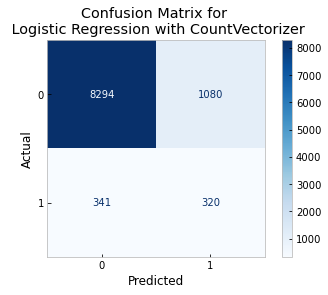

In [135]:
# generating standard confusion matrix
SVM_conf_matrix = plot_confusion_matrix(count_log_reg_baseline, X_test_count, y_test,
                                 display_labels=None,
                                 cmap=plt.cm.Blues)
SVM_conf_matrix.ax_.set_title('Confusion Matrix for \n Logistic Regression with CountVectorizer')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.grid(False)
plt.savefig(r'C:\Users\Ricky\Desktop\4.2 FINAL SEMESTER\PROJECT II  Computer systems Project\rOOT\Preprocessing\visualizations\log_reg_count_matrix.png', bbox_inches = "tight", pad_inches=.5)
plt.show()

From this confusion matrix, we can see that the True Negative rate is high, but the True Positive rate is much lower. **Let's normalize these values to get a better sense of this relationship.**

c:\Users\Ricky\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


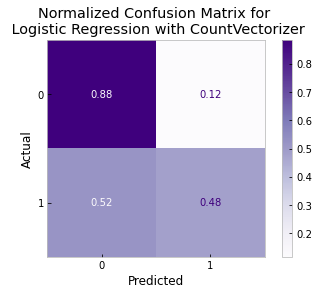

In [133]:
# generating normalized confusion matrix
SVM_conf_matrix = plot_confusion_matrix(count_log_reg_baseline, X_test_count, y_test,
                                 display_labels=None,
                                 cmap=plt.cm.Purples,
                                 normalize='true')
SVM_conf_matrix.ax_.set_title('Normalized Confusion Matrix for \n Logistic Regression with CountVectorizer')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.grid(False)
plt.savefig(r'C:\Users\Ricky\Desktop\4.2 FINAL SEMESTER\PROJECT II  Computer systems Project\rOOT\Preprocessing\visualizations\normalized_log_reg_countvec_matrix.png', bbox_inches = "tight", pad_inches=.5)
plt.show()

So as expected, the final model has a True Negative Rate of 88% and a True Positive Rate of 48%.

This is consistent with the final model's evaluation metrics, True Positive Rate. In this  context, we would ideally want as many True Positives as possible, because that would be identifying Hate Speech correctly. Therefore, this is where the final model could be improved.

Also, we can see that only .12% of predictions are False Positives. Which mean that they were classified as "Hate Speech" when it's not. It's great that this amount is low, because site users tend to launch complaint reports when their content is over-flagged as hate speech content when it's not.

Overall, the Recall of this model needs to be greatly improved, in addition to the F1 of 0.31053 .

***

# Conclusion

The final model had an F1 of 0.31053 and Recall of 0.4841. Although this project had extensive preprocessing and modeling iterations, there is still room for improvement.

It's important to understand why the model performed poorly and how that relates to the  problem. The F1 score was brought down by the "Hate Speech" label predictions. The model was able to predict 91% of the "Not Hate Speech" labels correctly, but could only predict 62% other label. 

**This performance is indicative of the two major roadblocks of the project:** 

1. Massive class imbalance of the dataset
2. Model's inability to "understand" the nuances of hate speech in swahili and English

The issue of class imbalance is manageable with preprocessing techniques and oversampling/undersampling techniques. However, identifying hate speech is an overall problem that many major tech companies like Twitter, Facebook and Instagram are still struggling with.

This is because the line between Hate Speech and regular offensive language is so fine. 

![venn](./visualizations/word_venn.png)

The code for this graph can be found in [`eda_notebook.ipynb`]

# Next Steps

To further develop this project, here are some immediate next steps that anyone could execute.

- Collect more potential "Hate Speech" data to be labeled bya teaam of trained annonators
- Improve final model with different preprocessing techniques, such as removing offensive language as stop words
- Evaluate model with new tweets or other online forum data to see if it can generalize well
- LDA Topic Modeling with Gensim
- Formation of a Swahili stops words